In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
!pip install numpy torch wandb swig gymnasium[box2d] matplotlib termcolor

zsh:1: no matches found: gymnasium[box2d]


In [3]:
import test
from utils import *

# Reinforcement Learning Part 1: DQN
By Lawrence Liu and Tonmoy Monsoor
## Some General Instructions

- As before, please keep the names of the layer consistent with what is requested in model.py. Otherwise the test functions will not work

- You will need to fill in the model.py, the DQN.py file, the buffer.py file, and the
env_wrapper.py

DO NOT use Windows for this project, gymnasium does is not supported for windows and installing it will be a pain.

### Introduction to the Enviroment
We will be training a DQN agent to play the game of CarRacing. The agent will be trained to play the game using the pixels of the game as an input. The reward structure is as follows for each frame:
- -0.1 for each frame
- +1000/N where N is the number of tiles visited by the car in the episode

The overall goal of this game is to design a agent that is able to play the game with a average test score of above 600. In discrete mode the actions can take 5 actions,
- 0: Do Nothing
- 1: Turn Left
- 2: Turn Right
- 3: Accelerate
- 4: Brake

First let us visualize the game and understand the environment.

In [78]:
import gymnasium as gym
import numpy as np
env = gym.make('CarRacing-v2', continuous=False, render_mode='rgb_array')
env.np_random = np.random.RandomState(42)

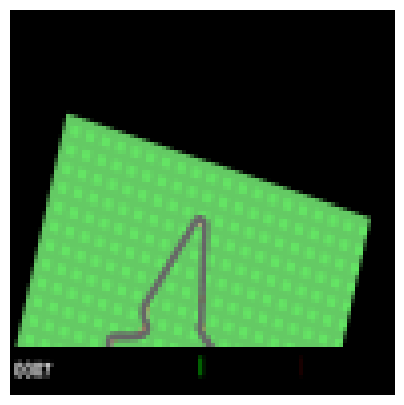

In [79]:

from IPython.display import HTML

frames = []
s, _ = env.reset()

while True:
    a = env.action_space.sample()
    s, r, terminated, truncated, _ = env.step(a)
    frames.append(s)
    if terminated or truncated:
        break


anim = animate(frames)
HTML(anim.to_jshtml())

So a couple things we can note:
- at the beginning of the game, we have 50 frames of the game slowly zooming into the car, we should ignore this period, ie no-op during this period.
- there is a black bar at the bottom of the screen, we should crop this out of the observation. 

In addition, another thing to note is that the current frame doesn't give much information about the velocity and acceleration of the car, and that the car does not move much for each frame.
### Environment Wrapper (5 points)
As a result, you will need to complete `EnvWrapper` in `env_wrapper.py`. You can find more information in the docstring for the wrapper, however the main idea is that it is a wrapper to the environment that does the following:
- skips the first 50 frames of the game
- crops out the black bar and reshapes the observation to a 84x84 image, as well as turning the resulting image to grayscale
- performs the actions for `skip_frames` frames
- stacks the last `num_frames` frames together to give the agent some information about the velocity and acceleration of the car.


In [81]:
from env_wrapper import EnvWrapper

test.test_wrapper(EnvWrapper)

Passed reset
Passed step


### CNN Model (5 points)
Now we are ready to build the model. Our architecture of the CNN model is the one proposed by Mnih et al in "Human-level control through deep reinforcement learning". Specifically this consists of the following layers:
- A convolutional layer with 32 filters of size 8x8 with stride 4 and relu activation
- A convolutional layer with 64 filters of size 4x4 with stride 2 and relu activation
- A convolutional layer with 64 filters of size 3x3 with stride 1 and relu activation
- A fully connected layer with 512 units and relu activation
- A fully connected layer with the number of outputs of the environment

Please implement this model `Nature_Paper_Conv` in `model.py` as well as the helper 
`MLP` class.

In [82]:
import model
test.test_model_DQN(model.Nature_Paper_Conv)

Passed


### DQN (40 points)
Now we are ready to implement the DQN algorithm. 

![title](DQN.png)

#### Replay Buffer (5 points)
First start by implementing the DQN replay buffer `ReplayBufferDQN` in `buffer.py`. This buffer will store the transitions of the agent and sample them for training. 

In [83]:
from replay_buffer import ReplayBufferDQN

test.test_DQN_replay_buffer(ReplayBufferDQN)

Passed



#### DQN (15 points)
Now implement the `_optimize_model` and `sample_action` functions in `DQN` in `DQN.py`. The `_optimize_model` function will sample a batch of transitions from the replay buffer and update the model. The `sample_action` function will sample an action from the model given the current state. Train the model over 200 episdoes, validating every 50 episodes for 30 episodes, before testing the model for 50 episodes at the end.

In [88]:
import DQN
import utils
import torch 


trainerDQN1 = DQN.DQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size=100000,
                batch_size=32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cpu',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 700, 0.1),
                save_path = utils.get_save_path("DQN","./runs/"))

out_mse = trainerDQN1.train(200,50,30,50,50)
                
                

saving to ./runs/DQN/run0
Episode: 1: Time: 13.082035064697266 Total Reward: -57.71186440678014 Avg_Loss: 0.4895160892610527
Episode: 2: Time: 17.856481075286865 Total Reward: -48.736654804271 Avg_Loss: 0.5356716240419686
Episode: 3: Time: 17.907886743545532 Total Reward: -62.34693877551075 Avg_Loss: 0.6517468516581825
Episode: 4: Time: 18.092222929000854 Total Reward: -7.547528517110129 Avg_Loss: 0.5748330331994456
Episode: 5: Time: 18.04525327682495 Total Reward: -22.53623188405811 Avg_Loss: 0.6390323862903008
Episode: 6: Time: 18.155301094055176 Total Reward: -38.57366771159924 Avg_Loss: 0.7418161563950927
Episode: 7: Time: 18.16043210029602 Total Reward: -30.691318327974717 Avg_Loss: 0.7235426040006285
Episode: 8: Time: 18.129841089248657 Total Reward: 57.77777777778201 Avg_Loss: 0.961006916683762
Episode: 9: Time: 18.364511966705322 Total Reward: 178.35640138408735 Avg_Loss: 1.0793944220332539
Episode: 10: Time: 18.094041109085083 Total Reward: -35.62500000000071 Avg_Loss: 1.22370

Episode: 84: Time: 18.142138242721558 Total Reward: 416.9999999999958 Avg_Loss: 5.612673391814993
Episode: 85: Time: 18.4061918258667 Total Reward: 319.492753623184 Avg_Loss: 5.195713648275167
Episode: 86: Time: 18.25415301322937 Total Reward: 528.2394366197111 Avg_Loss: 6.193075724509584
Episode: 87: Time: 18.327216863632202 Total Reward: 343.4858044164013 Avg_Loss: 5.504364591185786
Episode: 88: Time: 18.179681062698364 Total Reward: 359.5454545454494 Avg_Loss: 5.4503538037548545
Episode: 89: Time: 18.26184606552124 Total Reward: 5.977198697067816 Avg_Loss: 5.654433987721675
Episode: 90: Time: 18.217226028442383 Total Reward: 180.98566308244153 Avg_Loss: 5.519748319096926
Episode: 91: Time: 18.269148111343384 Total Reward: 444.2857142857073 Avg_Loss: 5.6215470127698755
Episode: 92: Time: 18.24690008163452 Total Reward: 270.5172413793123 Avg_Loss: 5.845609871780171
Episode: 93: Time: 18.235082864761353 Total Reward: 356.72413793103215 Avg_Loss: 5.225014079017799
Episode: 94: Time: 18.

Episode: 166: Time: 17.96447205543518 Total Reward: 132.94117647059218 Avg_Loss: 6.775438674357759
Episode: 167: Time: 18.11350417137146 Total Reward: 348.66197183098706 Avg_Loss: 7.16400932464279
Episode: 168: Time: 18.020145893096924 Total Reward: 304.3506493506491 Avg_Loss: 6.943542195969269
Episode: 169: Time: 18.52626395225525 Total Reward: 406.5479876160962 Avg_Loss: 6.4173817043544865
Episode: 170: Time: 18.629361867904663 Total Reward: 329.1379310344759 Avg_Loss: 6.437998766658687
Episode: 171: Time: 18.5725998878479 Total Reward: 455.4885993485277 Avg_Loss: 7.113273433276585
Episode: 172: Time: 18.536601066589355 Total Reward: 365.8150470219387 Avg_Loss: 7.059104294336143
Episode: 173: Time: 18.406563997268677 Total Reward: 423.9003436426087 Avg_Loss: 6.942892452248004
Episode: 174: Time: 18.16997194290161 Total Reward: 325.13888888889 Avg_Loss: 6.5807209024910165
Episode: 175: Time: 18.126417875289917 Total Reward: 292.4538745387388 Avg_Loss: 7.062607043430585
Episode: 176: T

In [89]:
trainerDQN2 = DQN.DQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size=100000,
                batch_size=32,
                loss_fn = "smooth_l1_loss",
                use_wandb = False,
                device = 'cpu',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 700,0.1),
                save_path = utils.get_save_path("DQN","./runs/"))

out_l1 = trainerDQN2.train(200,50,30,50,50)
                

saving to ./runs/DQN/run1
Episode: 1: Time: 13.697196960449219 Total Reward: -40.578231292517756 Avg_Loss: 0.13669895916690777
Episode: 2: Time: 18.738681077957153 Total Reward: -66.53024911032085 Avg_Loss: 0.14641240352428198
Episode: 3: Time: 18.74876308441162 Total Reward: -71.02739726027448 Avg_Loss: 0.11805925721365239
Episode: 4: Time: 18.71462082862854 Total Reward: -82.26114649681492 Avg_Loss: 0.10940684976463183
Episode: 5: Time: 18.661263942718506 Total Reward: -59.705882352941636 Avg_Loss: 0.10656297952621518
Episode: 6: Time: 18.547620058059692 Total Reward: -56.26760563380327 Avg_Loss: 0.11676109245070453
Episode: 7: Time: 18.43413209915161 Total Reward: -84.09090909090872 Avg_Loss: 0.11963350077241879
Episode: 8: Time: 18.308965921401978 Total Reward: -29.853420195440265 Avg_Loss: 0.11629590964602197
Episode: 9: Time: 17.528201818466187 Total Reward: -103.38791208791196 Avg_Loss: 0.12750743260082492
Episode: 10: Time: 18.157769203186035 Total Reward: -26.407942238267864 A

Episode: 83: Time: 17.68531608581543 Total Reward: 502.2222222222158 Avg_Loss: 1.0311509353273056
Episode: 84: Time: 17.619313955307007 Total Reward: 185.44280442804873 Avg_Loss: 1.027345991560391
Episode: 85: Time: 17.760406017303467 Total Reward: 496.69550173009725 Avg_Loss: 1.08883251387532
Episode: 86: Time: 17.98920512199402 Total Reward: 289.32835820895696 Avg_Loss: 1.0815375089144506
Episode: 87: Time: 17.930089950561523 Total Reward: 356.7374517374443 Avg_Loss: 1.0414030373472125
Episode: 88: Time: 18.195363998413086 Total Reward: 380.0830564783992 Avg_Loss: 1.1424517409891641
Episode: 89: Time: 18.121834993362427 Total Reward: 412.5187969924686 Avg_Loss: 1.118601833446687
Episode: 90: Time: 18.227668046951294 Total Reward: 382.8481012658179 Avg_Loss: 1.1771620900190176
Episode: 91: Time: 18.027714014053345 Total Reward: 269.9635036496382 Avg_Loss: 1.142725749676969
Episode: 92: Time: 18.15070104598999 Total Reward: 556.7241379310241 Avg_Loss: 1.2236027463394052
Episode: 93: Ti

Episode: 164: Time: 23.42771005630493 Total Reward: 567.9213483145977 Avg_Loss: 1.6404050002578927
Episode: 165: Time: 23.712730169296265 Total Reward: 452.5409836065482 Avg_Loss: 1.6160642619894332
Episode: 166: Time: 23.41264581680298 Total Reward: 682.385159010588 Avg_Loss: 1.4927846526398378
Episode: 167: Time: 23.340200185775757 Total Reward: 638.8129496402737 Avg_Loss: 1.5835837125778198
Episode: 168: Time: 23.429304122924805 Total Reward: 556.5679442508614 Avg_Loss: 1.4214394851392056
Episode: 169: Time: 23.538545846939087 Total Reward: 615.8843537414891 Avg_Loss: 1.6086778660782246
Episode: 170: Time: 23.766814947128296 Total Reward: 427.59887005648966 Avg_Loss: 1.6265828679589664
Episode: 171: Time: 23.571732997894287 Total Reward: 563.6206896551626 Avg_Loss: 1.6033900325037853
Episode: 172: Time: 23.58040690422058 Total Reward: 541.6559485530476 Avg_Loss: 1.5898715816125149
Episode: 173: Time: 23.343698024749756 Total Reward: 628.0215827338044 Avg_Loss: 1.5734293728816409
Epi

Please include a plot of the training and validation rewards over the episodes in the report. An additional question to answer is does the loss matter in DQN? Why or why not?

We can also draw a animation of the car in one game, the code is provided below

**Ans.** Yes, the loss function matters. If the loss function is not decided correctly either the loss may decrease, the rewards won't increase over time necessarily. The choice of loss function in DQN is essential for training stability, convergence, and achieving optimal performance. Different loss functions may be suitable for different scenarios or variations of the DQN algorithm.

To decide whether MSE loss is better or smooth L1 loss, we should pay attention to the charactristics of our problem. MSE loss tends to penalize larger errors more heavily, which can be suitable if we want to prioritize reducing large errors. However, it is more sensitive to outliers and can amplify their impact on the training process, potentially leading to slower convergence or instability; whereas Smooth L1 loss offers a combination of both L1 and L2 loss functions. It behaves like L2 loss for small errors and like L1 loss for large errors. Smooth L1 loss is less sensitive to outliers and can provide more robust training by reducing the impact of extreme errors. It can be particularly useful if the problem involves a high degree of noise or outliers in the target Q-values.

As shown above, smooth L1 loss worked a little better. The test mean rewards are nearly the same but standard deviation is smaller for smooth L1. For this case, smooth L1 worked better probably due to the existance of some noise.


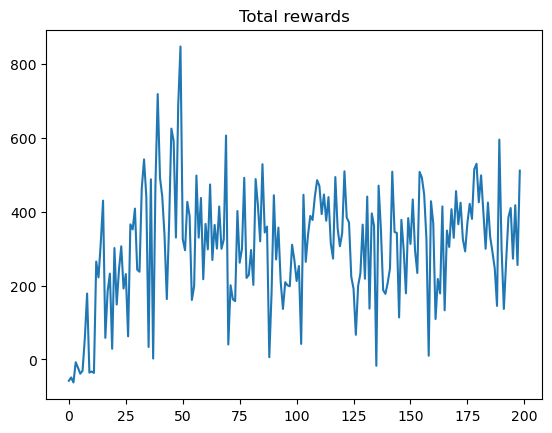

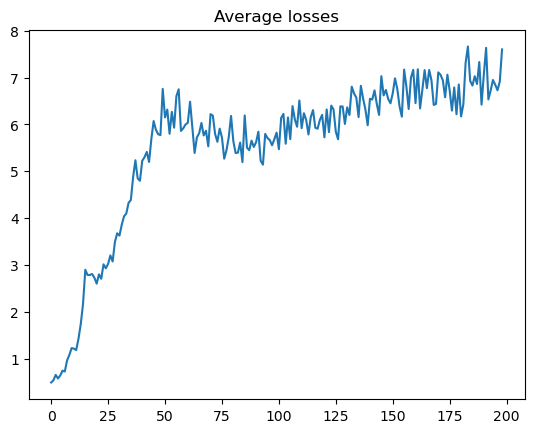

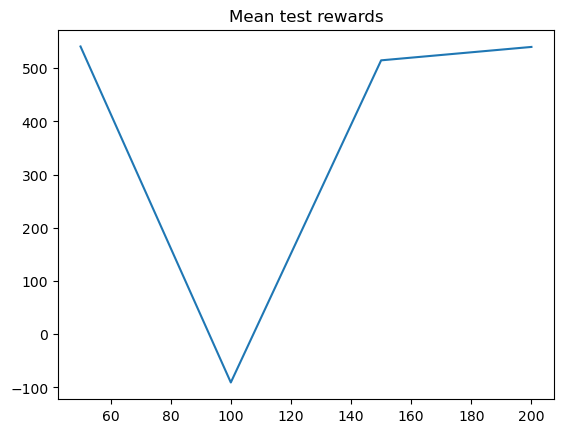

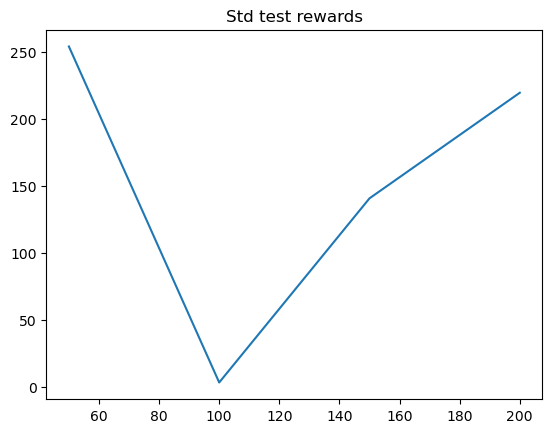

In [130]:
# Plots for a trainer trained by MSE loss
import matplotlib.pyplot as plt

avg_losses, total_rewards, mean_test_rewards, std_test_rewards = out_mse

plt.plot(total_rewards)
plt.title("Total rewards")
plt.show();

plt.plot(avg_losses)
plt.title("Average losses")
plt.show();

x = np.arange(50, 201, 50)
plt.plot(x, mean_test_rewards)
plt.title("Mean test rewards")
plt.show();

plt.plot(x, std_test_rewards)
plt.title("Std test rewards")
plt.show();

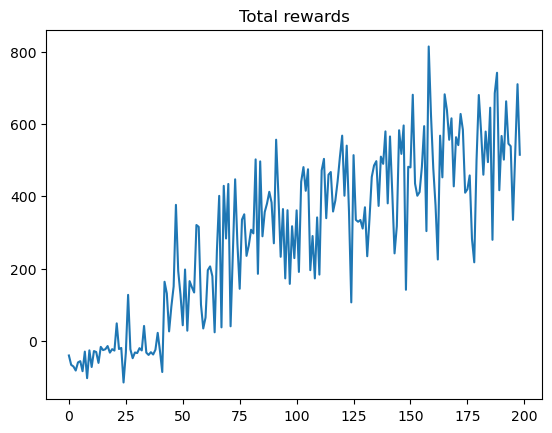

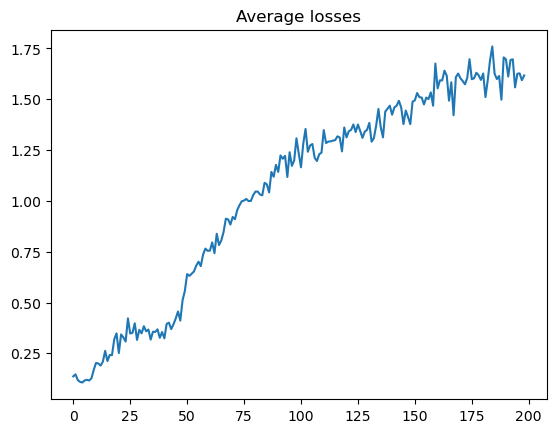

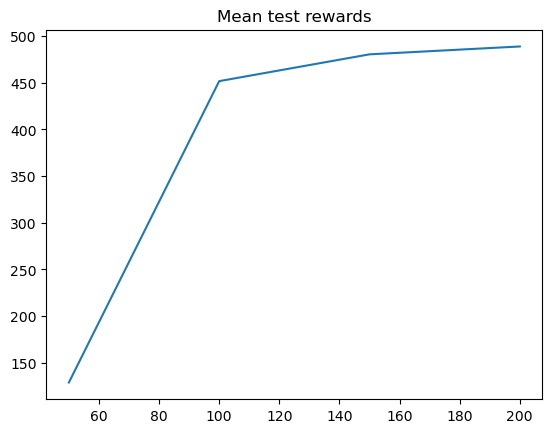

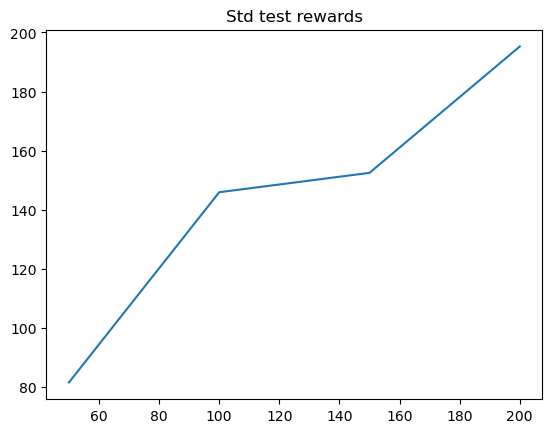

In [98]:
# Plots for a trainer trained by smooth l1 loss

avg_losses, total_rewards, mean_test_rewards, std_test_rewards = out_l1

plt.plot(total_rewards)
plt.title("Total rewards")
plt.show();

plt.plot(avg_losses)
plt.title("Average losses")
plt.show();

x = np.arange(50, 201, 50)
plt.plot(x, mean_test_rewards)
plt.title("Mean test rewards")
plt.show();

plt.plot(x, std_test_rewards)
plt.title("Std test rewards")
plt.show();

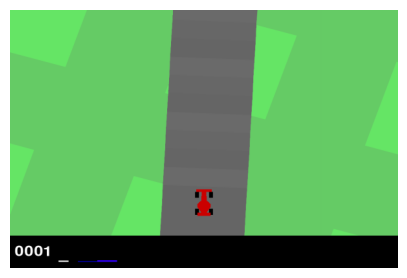

In [105]:
# animation for a trainer trained by MSE loss
eval_env = gym.make('CarRacing-v2', continuous=True, render_mode='rgb_array')
eval_env = EnvWrapper(eval_env)

total_rewards, frames = trainerDQN1.play_episode(0,True,42)
anim = animate(frames)
HTML(anim.to_jshtml())

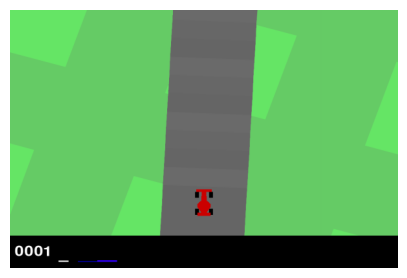

In [99]:
# animation for a trainer trained by smooth l1 loss
eval_env = gym.make('CarRacing-v2', continuous=True, render_mode='rgb_array')
eval_env = EnvWrapper(eval_env)

total_rewards, frames = trainerDQN2.play_episode(0,True,42)
anim = animate(frames)
HTML(anim.to_jshtml())

### Double DQN
In the original paper, where the algorithim is shown above, the estimated target Q value was computed using the current Q network's weights. However, this can lead to overestimation of the Q values. To mitigate this, we can use the target network to compute the target Q value. This is known as Double DQN.
#### Hard updating Target Network (5 points)
Original implementations for this involved hard updates, where the model weights were copied to the target network every C steps. This is known as hard updating. This was what was used in the Nature Paper by Mnih et al 2015 "Human-level control through deep reinforcement learning"

Please implement this by implementing the `_optimize_model` and `_update_model` classes in `HardUpdateDQN` in `DQN.py`.


In [118]:
trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 100,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size=100000,
                batch_size=32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cpu',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates/","./runs/"))

trainerHardUpdateDQN.train(200,50,30,50,50)

saving to ./runs/DoubleDQN_HardUpdates/run0
Episode: 1: Time: 17.792473793029785 Total Reward: -63.75000000000068 Avg_Loss: 0.630705767222176
Episode: 2: Time: 23.915672063827515 Total Reward: -84.16967509025231 Avg_Loss: 0.52350636603342
Episode: 3: Time: 24.071273803710938 Total Reward: -31.09022556391058 Avg_Loss: 0.5189976973044333
Episode: 4: Time: 23.95846199989319 Total Reward: -30.483870967742114 Avg_Loss: 0.610305790711163
Episode: 5: Time: 24.009126901626587 Total Reward: -7.33766233766292 Avg_Loss: 0.674683321549111
Episode: 6: Time: 24.103214025497437 Total Reward: -53.47750865051944 Avg_Loss: 0.7039703618609855
Episode: 7: Time: 24.01707911491394 Total Reward: -23.57142857142929 Avg_Loss: 0.7277495655379876
Episode: 8: Time: 23.977355003356934 Total Reward: -78.16498316498306 Avg_Loss: 0.6769561887006549
Episode: 9: Time: 24.818693161010742 Total Reward: -31.50793650793713 Avg_Loss: 0.6265656726763529
Episode: 10: Time: 24.082226991653442 Total Reward: -30.18518518518591 A

Episode: 84: Time: 24.211642026901245 Total Reward: 567.1160409556212 Avg_Loss: 8.189190772401185
Episode: 85: Time: 19.145009756088257 Total Reward: 394.5833333333301 Avg_Loss: 7.5477354035658
Episode: 86: Time: 18.706461906433105 Total Reward: 455.5226480836171 Avg_Loss: 7.674428782042335
Episode: 87: Time: 18.69327712059021 Total Reward: 605.3484320557403 Avg_Loss: 7.52655442923057
Episode: 88: Time: 18.475342273712158 Total Reward: 431.7175572518991 Avg_Loss: 8.3595830242173
Episode: 89: Time: 18.417510986328125 Total Reward: 238.33333333333516 Avg_Loss: 8.323326017676282
Episode: 90: Time: 18.507752895355225 Total Reward: 273.2432432432443 Avg_Loss: 8.590620316377207
Episode: 91: Time: 18.715154886245728 Total Reward: 150.73378839590598 Avg_Loss: 8.675868487157741
Episode: 92: Time: 18.553852796554565 Total Reward: 329.05063291139226 Avg_Loss: 8.636651369703918
Episode: 93: Time: 18.37106990814209 Total Reward: 301.8871595330669 Avg_Loss: 8.163391015108894
Episode: 94: Time: 18.91

Episode: 166: Time: 17.522963285446167 Total Reward: 243.59368770763297 Avg_Loss: 7.218133349224453
Episode: 167: Time: 18.80939483642578 Total Reward: 619.2857142857035 Avg_Loss: 7.901547805601809
Episode: 168: Time: 18.587332010269165 Total Reward: 500.46925566342145 Avg_Loss: 8.134706851814975
Episode: 169: Time: 18.81227684020996 Total Reward: 442.73584905659885 Avg_Loss: 7.920106151524712
Episode: 170: Time: 19.098884105682373 Total Reward: 353.97959183673294 Avg_Loss: 7.982888856855761
Episode: 171: Time: 18.691712141036987 Total Reward: 595.9090909090784 Avg_Loss: 7.2928816741254145
Episode: 172: Time: 18.66236400604248 Total Reward: 575.2508960573359 Avg_Loss: 8.388004270922236
Episode: 173: Time: 18.818603038787842 Total Reward: 545.522875816986 Avg_Loss: 8.549828620517955
Episode: 174: Time: 18.928699254989624 Total Reward: 456.85185185183957 Avg_Loss: 7.820556531433298
Episode: 175: Time: 18.62218976020813 Total Reward: 481.47058823528437 Avg_Loss: 7.87028297256021
Episode: 

([0.630705767222176,
  0.52350636603342,
  0.5189976973044333,
  0.610305790711163,
  0.674683321549111,
  0.7039703618609855,
  0.7277495655379876,
  0.6769561887006549,
  0.6265656726763529,
  0.6642914196131986,
  0.7320616529831866,
  0.9139129687413698,
  1.026351731834041,
  1.2644980702893573,
  1.5278667289168895,
  1.8232483788698661,
  2.0219053126433315,
  2.0739796490979794,
  2.1165331719737304,
  3.184624611705291,
  4.715633521310422,
  3.873302436676346,
  5.189784720039167,
  2.932057719771602,
  4.435361351208253,
  6.892269643665362,
  8.870944892658907,
  7.0525425457153,
  3.4879929215467276,
  6.0149259444545295,
  4.515603584526968,
  5.633008697203228,
  4.871360142942236,
  5.144679617981951,
  6.706640308394151,
  5.6151600835704,
  6.632896581617724,
  6.415923565876584,
  6.382485403734095,
  6.133016110969191,
  6.778691347907571,
  7.2234457771317295,
  6.590719760466023,
  6.030666870730264,
  6.587396972820539,
  7.979168384015059,
  7.880866835097305,
 

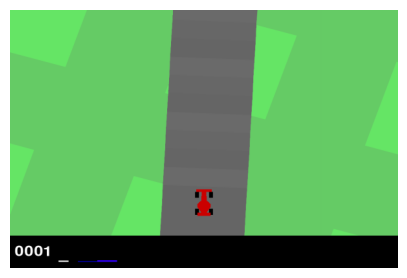

In [119]:
total_rewards, frames = trainerHardUpdateDQN.play_episode(0,True,42)
anim = animate(frames)
HTML(anim.to_jshtml())

#### Soft Updates (5 points)
A more recent improvement is to use soft updates, also known as Polyak averaging, where the target network is updated with a small fraction of the current model weights every step. In other words:
$$\theta_{target} = \tau \theta_{model} + (1-\tau) \theta_{target}$$
for some $\tau << 1$
Please implement this by implementing the `_update_model` class in `SoftUpdateDQN` in `DQN.py`.

In [125]:
traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.01,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size=100000,
                batch_size=32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cpu',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200,50,30,50,50)

saving to ./runs/DoubleDQN_SoftUpdates/run0
Episode: 1: Time: 13.38784122467041 Total Reward: -44.64028776978459 Avg_Loss: 0.7032929947659089
Episode: 2: Time: 18.21323871612549 Total Reward: -56.0389610389619 Avg_Loss: 0.6477146975758696
Episode: 3: Time: 18.280731201171875 Total Reward: -59.78873239436666 Avg_Loss: 0.5800422116832322
Episode: 4: Time: 18.35274910926819 Total Reward: -5.394265232975001 Avg_Loss: 0.6849102419370613
Episode: 5: Time: 19.05089044570923 Total Reward: -32.72893772893818 Avg_Loss: 0.7501259394177869
Episode: 6: Time: 18.543907165527344 Total Reward: -6.184210526316598 Avg_Loss: 0.7486689495658424
Episode: 7: Time: 18.786283016204834 Total Reward: 36.94444444444324 Avg_Loss: 0.8814797621815145
Episode: 8: Time: 22.17089295387268 Total Reward: -33.628158844765835 Avg_Loss: 0.9176623095609561
Episode: 9: Time: 24.634217977523804 Total Reward: -12.293233082707298 Avg_Loss: 0.871715443678388
Episode: 10: Time: 24.014771223068237 Total Reward: -26.8996415770615 A

Episode: 83: Time: 18.443274974822998 Total Reward: -37.238267148014856 Avg_Loss: 6.270810764376857
Episode: 84: Time: 18.500017166137695 Total Reward: 254.4809688581352 Avg_Loss: 6.02737505596225
Episode: 85: Time: 18.433401823043823 Total Reward: 298.5018050541516 Avg_Loss: 5.694585790153311
Episode: 86: Time: 18.515270709991455 Total Reward: 339.78260869564576 Avg_Loss: 6.182177367330599
Episode: 87: Time: 19.035494327545166 Total Reward: 401.8152866241946 Avg_Loss: 5.996060750564607
Episode: 88: Time: 18.711929321289062 Total Reward: 370.11627906976213 Avg_Loss: 6.450168994795375
Episode: 89: Time: 19.03132700920105 Total Reward: 265.7594936708896 Avg_Loss: 5.4398660444411915
Episode: 90: Time: 18.665558099746704 Total Reward: 188.27645051194932 Avg_Loss: 5.964842142177229
Episode: 91: Time: 18.57802391052246 Total Reward: 394.5833333333296 Avg_Loss: 6.15013685747355
Episode: 92: Time: 18.88603901863098 Total Reward: 528.6933797909309 Avg_Loss: 6.24037806877569
Episode: 93: Time: 1

Episode: 165: Time: 24.46898913383484 Total Reward: 717.7340823969928 Avg_Loss: 7.231713039033553
Episode: 166: Time: 24.648165225982666 Total Reward: 306.9933554817293 Avg_Loss: 7.152861952781677
Episode: 167: Time: 25.57377314567566 Total Reward: 599.5337620578658 Avg_Loss: 7.324667753291731
Episode: 168: Time: 25.195861101150513 Total Reward: 404.9999999999983 Avg_Loss: 6.737079249710596
Episode: 169: Time: 25.141915798187256 Total Reward: 175.8333333333383 Avg_Loss: 6.770755751794126
Episode: 170: Time: 24.88740086555481 Total Reward: 544.8601398601315 Avg_Loss: 6.736490658852232
Episode: 171: Time: 24.818866968154907 Total Reward: 253.68421052630913 Avg_Loss: 6.736501869033365
Episode: 172: Time: 25.51734709739685 Total Reward: 496.36212624583777 Avg_Loss: 6.728963853932228
Episode: 173: Time: 25.04335308074951 Total Reward: 430.09652509652193 Avg_Loss: 7.041211037074818
Episode: 174: Time: 24.681636810302734 Total Reward: 503.70550161811246 Avg_Loss: 6.9307246879369275
Episode: 1

([0.7032929947659089,
  0.6477146975758696,
  0.5800422116832322,
  0.6849102419370613,
  0.7501259394177869,
  0.7486689495658424,
  0.8814797621815145,
  0.9176623095609561,
  0.871715443678388,
  0.9815360074784575,
  1.0410380279567062,
  1.1218535047368843,
  1.2063556467848164,
  1.27918864619233,
  4.027322133627316,
  4.554474374764607,
  3.0497909548277615,
  1.3030801909803833,
  2.6935463223387215,
  1.6022877284959585,
  2.7878835389093193,
  1.7956996214489978,
  2.1934938334366856,
  2.3625617214043935,
  5.594311775780525,
  4.938372734464517,
  2.1076705150243615,
  2.2607203315035638,
  2.33925094912533,
  2.768643808715484,
  2.8379861698681568,
  4.983561173832717,
  5.105834620589969,
  6.792224825179877,
  4.27089317456013,
  5.352592559421764,
  4.613672426768711,
  6.682771241464534,
  6.552195939196258,
  6.0563742956694435,
  6.441372477707743,
  6.266093687350009,
  6.28730186995338,
  5.177256118850548,
  5.987423268185944,
  5.979899812145393,
  6.1903411119

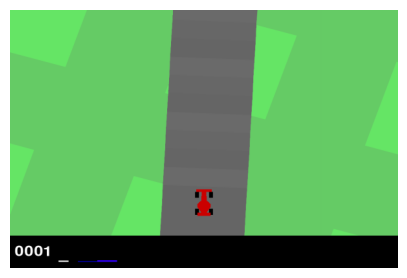

In [126]:
total_rewards, frames = traineSoftUpdateDQN.play_episode(0,True,42)
anim = animate(frames)
HTML(anim.to_jshtml())

#### Questions:
- Which method performed better? (5 points)
- If we modify the $\tau$ for soft updates or the $C$ for the hard updates, how does this affect the performance of the model, come up with a intuition for this, then experimentally verify this.
 (5 points)


**Ans.** 
- DQN with soft updates > vanila DQN > DQN with hard updates.
- Raising 𝐶 reduces updates, speeds up training but risks outdated networks, slower convergence, and less accurate Q-value estimates. Increasing 𝜏 in Soft Updates slows updates, therefore, enhances stability but risks slower convergence and adaptation. As you can see below, we increased C for hard updates to 200, leading to a slower convergence but better results than before. We also increased 𝜏 to 0.3 in soft updates, resulting in an increase with the stability of the model, slower updates, and also better results.

In [133]:
trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 200,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size=100000,
                batch_size=32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cpu',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates/","./runs/"))

trainerHardUpdateDQN.train(200,50,30,50,50)

saving to ./runs/DoubleDQN_HardUpdates/run3
Episode: 1: Time: 18.100610971450806 Total Reward: -31.708860759494037 Avg_Loss: 0.820937740907168
Episode: 2: Time: 24.25102162361145 Total Reward: -40.762711864407095 Avg_Loss: 0.8298551891969532
Episode: 3: Time: 24.652439832687378 Total Reward: -41.20253164557029 Avg_Loss: 0.7261427032346485
Episode: 4: Time: 24.62842631340027 Total Reward: -43.08743169398939 Avg_Loss: 0.678266048055737
Episode: 5: Time: 24.391802072525024 Total Reward: -37.942942942943475 Avg_Loss: 0.6597021974451026
Episode: 6: Time: 24.475948810577393 Total Reward: -32.95620437956265 Avg_Loss: 0.6943003801988954
Episode: 7: Time: 24.12496304512024 Total Reward: -30.06493506493574 Avg_Loss: 0.7574385171051786
Episode: 8: Time: 24.135298252105713 Total Reward: -30.251798561151407 Avg_Loss: 0.6477190712858149
Episode: 9: Time: 24.13827419281006 Total Reward: -85.25974025973977 Avg_Loss: 0.641771079080195
Episode: 10: Time: 27.539865255355835 Total Reward: -63.309859154930

Episode: 83: Time: 24.205204010009766 Total Reward: 286.41025641025595 Avg_Loss: 4.961310871008064
Episode: 84: Time: 6.477529048919678 Total Reward: -61.44905660377387 Avg_Loss: 5.2851335305434
Episode: 85: Time: 24.353999137878418 Total Reward: 151.79487179487413 Avg_Loss: 8.26195216930213
Episode: 86: Time: 24.08628010749817 Total Reward: 28.55212355212548 Avg_Loss: 5.074071414330426
Episode: 87: Time: 24.042032957077026 Total Reward: 342.7224199288254 Avg_Loss: 4.938717095791793
Episode: 88: Time: 24.03946805000305 Total Reward: 425.5992509363207 Avg_Loss: 5.031276339743318
Episode: 89: Time: 24.244354009628296 Total Reward: 241.50793650793923 Avg_Loss: 4.914846381720374
Episode: 90: Time: 24.0889310836792 Total Reward: 500.6678700360931 Avg_Loss: 5.255969357089836
Episode: 91: Time: 24.211157083511353 Total Reward: 337.5259515570859 Avg_Loss: 6.335310681026523
Episode: 92: Time: 24.040297985076904 Total Reward: 392.3646209386246 Avg_Loss: 5.407486358610522
Episode: 93: Time: 24.10

Episode: 165: Time: 19.107198238372803 Total Reward: 394.6551724137886 Avg_Loss: 5.902027753220887
Episode: 166: Time: 19.161369800567627 Total Reward: 453.821548821536 Avg_Loss: 5.636468718532755
Episode: 167: Time: 19.289504051208496 Total Reward: 377.89156626505496 Avg_Loss: 6.263388074245773
Episode: 168: Time: 19.11868405342102 Total Reward: 616.1913357400624 Avg_Loss: 6.873990818732927
Episode: 169: Time: 19.13919997215271 Total Reward: 419.1843971631158 Avg_Loss: 6.404269650202839
Episode: 170: Time: 19.18834090232849 Total Reward: 460.92105263156884 Avg_Loss: 6.263270647585893
Episode: 171: Time: 19.113001108169556 Total Reward: 261.401384083048 Avg_Loss: 6.352828298296247
Episode: 172: Time: 18.982282876968384 Total Reward: 354.43820224718337 Avg_Loss: 6.045260823073507
Episode: 173: Time: 18.913387060165405 Total Reward: 240.54817275747786 Avg_Loss: 6.507352567520462
Episode: 174: Time: 19.300755262374878 Total Reward: 342.29903536977037 Avg_Loss: 6.223971242664241
Episode: 1

([0.820937740907168,
  0.8298551891969532,
  0.7261427032346485,
  0.678266048055737,
  0.6597021974451026,
  0.6943003801988954,
  0.7574385171051786,
  0.6477190712858149,
  0.641771079080195,
  0.6105592137656543,
  0.6308907887765339,
  0.6612010868031437,
  0.7037577274247628,
  0.7539445211437821,
  0.784094048930066,
  0.7451601366849006,
  0.7497997194716409,
  0.862367572028096,
  0.9059205599943129,
  1.0743605771861156,
  1.2333044959466999,
  1.3613839353896489,
  1.299452933130645,
  1.1972777161966353,
  1.3706221135348833,
  1.5413459511865086,
  1.854454691670522,
  1.9144588631241262,
  2.0782367310353687,
  2.033498555672269,
  2.2022186645439694,
  2.584135141442804,
  2.7975101751439713,
  3.13859794044695,
  2.9012930012550675,
  2.7518174052238464,
  2.602452131629992,
  2.490580059149686,
  2.676145635232204,
  3.0447231716468552,
  3.0021196769065215,
  3.218664873422695,
  3.4549734439669537,
  3.540909213178298,
  3.669427632784643,
  3.413881740650209,
  3.25

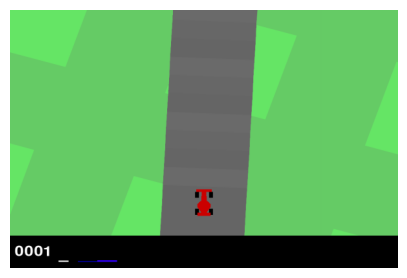

In [135]:
total_rewards, frames = trainerHardUpdateDQN.play_episode(0,True,42)
anim = animate(frames)
HTML(anim.to_jshtml())

In [127]:
traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.3,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size=100000,
                batch_size=32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cpu',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200,50,30,50,50)

saving to ./runs/DoubleDQN_SoftUpdates/run1
Episode: 1: Time: 18.07413673400879 Total Reward: -27.659932659933013 Avg_Loss: 0.8300108550840123
Episode: 2: Time: 24.553028106689453 Total Reward: -49.385964912281366 Avg_Loss: 0.7992296721629736
Episode: 3: Time: 24.530145168304443 Total Reward: -25.37974683544328 Avg_Loss: 0.7479331327774444
Episode: 4: Time: 24.336063861846924 Total Reward: -37.37288135593228 Avg_Loss: 0.7622552723193369
Episode: 5: Time: 24.379772901535034 Total Reward: -28.54430379746848 Avg_Loss: 0.7252162662373871
Episode: 6: Time: 24.57474374771118 Total Reward: -29.426229508197164 Avg_Loss: 0.7652347375552694
Episode: 7: Time: 24.163302183151245 Total Reward: -37.94294294294362 Avg_Loss: 0.8004983032137907
Episode: 8: Time: 23.828334093093872 Total Reward: -29.30656934306619 Avg_Loss: 0.735148368418968
Episode: 9: Time: 23.912610054016113 Total Reward: -36.55844155844227 Avg_Loss: 0.7089617055754701
Episode: 10: Time: 23.95942711830139 Total Reward: -33.8489208633

Episode: 83: Time: 23.76634192466736 Total Reward: 222.56756756757227 Avg_Loss: 6.366574479752228
Episode: 84: Time: 23.758791208267212 Total Reward: 538.5616438356057 Avg_Loss: 7.061873446993467
Episode: 85: Time: 23.785446882247925 Total Reward: 344.10256410255903 Avg_Loss: 6.663345629427614
Episode: 86: Time: 23.59667682647705 Total Reward: 455.9433962264061 Avg_Loss: 6.096195738355653
Episode: 87: Time: 23.800740242004395 Total Reward: 501.15384615384147 Avg_Loss: 6.181015587654434
Episode: 88: Time: 23.62913990020752 Total Reward: 372.18146718146676 Avg_Loss: 6.287966750249141
Episode: 89: Time: 23.59816026687622 Total Reward: 513.5409252668956 Avg_Loss: 6.040209119059458
Episode: 90: Time: 23.558493852615356 Total Reward: 639.0823970037354 Avg_Loss: 6.148835222260291
Episode: 91: Time: 23.786091089248657 Total Reward: 381.1904761904707 Avg_Loss: 6.140472198233885
Episode: 92: Time: 23.58467197418213 Total Reward: 414.0252707581153 Avg_Loss: 6.393856681695505
Episode: 93: Time: 23

Episode: 165: Time: 23.628339767456055 Total Reward: 570.4929577464707 Avg_Loss: 7.286853023937771
Episode: 166: Time: 23.989874124526978 Total Reward: 511.8111455108276 Avg_Loss: 6.479278967160137
Episode: 167: Time: 23.811520099639893 Total Reward: 625.6896551724005 Avg_Loss: 6.699736808528419
Episode: 168: Time: 23.83064603805542 Total Reward: 460.55555555555134 Avg_Loss: 6.457543641579251
Episode: 169: Time: 23.96686625480652 Total Reward: 447.1686746987889 Avg_Loss: 7.201328754425049
Episode: 170: Time: 23.71521782875061 Total Reward: 479.00722021659595 Avg_Loss: 7.818225259540462
Episode: 171: Time: 23.818684816360474 Total Reward: 326.98581560283804 Avg_Loss: 7.183639678634515
Episode: 172: Time: 23.79445791244507 Total Reward: 319.4736842105234 Avg_Loss: 7.154375471988646
Episode: 173: Time: 23.740927934646606 Total Reward: 558.9792387543155 Avg_Loss: 6.946575574514244
Episode: 174: Time: 23.425029039382935 Total Reward: 32.340823970040006 Avg_Loss: 6.7369162886082625
Episode: 

([0.8300108550840123,
  0.7992296721629736,
  0.7479331327774444,
  0.7622552723193369,
  0.7252162662373871,
  0.7652347375552694,
  0.8004983032137907,
  0.735148368418968,
  0.7089617055754701,
  0.6998507880425754,
  0.6667009149091083,
  0.7642510254092577,
  0.8437968341931075,
  1.0328185649103476,
  1.0345290218706893,
  1.1972487048566842,
  1.4567115618025555,
  1.5350821574195093,
  1.4080379387410749,
  1.5451214755533123,
  1.530254575572595,
  1.885333669411034,
  2.2900999418827666,
  2.5265566681613443,
  2.756238182051843,
  2.502442905381948,
  2.1546780967912755,
  2.59941013733379,
  3.0896950704710826,
  2.699759793381731,
  3.049805957980517,
  3.4621525126345016,
  3.1284506323457766,
  3.183662277059395,
  3.6082325252164313,
  3.8849641199873277,
  3.9139280279143516,
  3.6640041653348616,
  3.645185566249014,
  3.7821127163762807,
  4.0907911127354915,
  4.557052588763357,
  4.904789734287422,
  5.569140385679838,
  5.347582130872903,
  5.541219190890048,
  4.

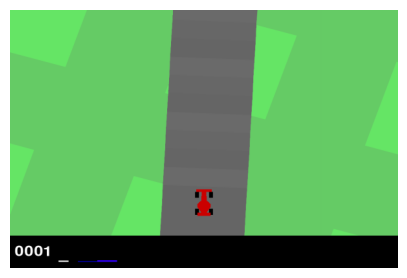

In [136]:
total_rewards, frames = traineSoftUpdateDQN.play_episode(0,True,42)
anim = animate(frames)
HTML(anim.to_jshtml())